# Kernel Regularized Least Squares


In [1]:
from MixGauss import *
from regularizedKernLSTrain import *
from regularizedKernLSTest import * 
from separatingFKernRLS import *
from flipLabels import * 
from two_moons import *
from holdoutCVKernRLS import *
import numpy as np
import matplotlib.pyplot as plt

Exercise 1

In [2]:
Xtr, Ytr = MixGauss(means=[[0,0],[1,1]], sigmas=[0.5, 0.3], n=100)
Xts, Yts = MixGauss(means=[[0,0],[1,1]], sigmas=[0.5, 0.3], n=100)
Ytr = 2*np.mod(Ytr, 2)-1
Yts = 2*np.mod(Yts, 2)-1

In [3]:
sigma_values = [0.1, 0.5, 1, 2, 5, 10]
lam_values = [1e-10, 1e-5, 1e-2, 1, 5, 10]

Exercise 1C

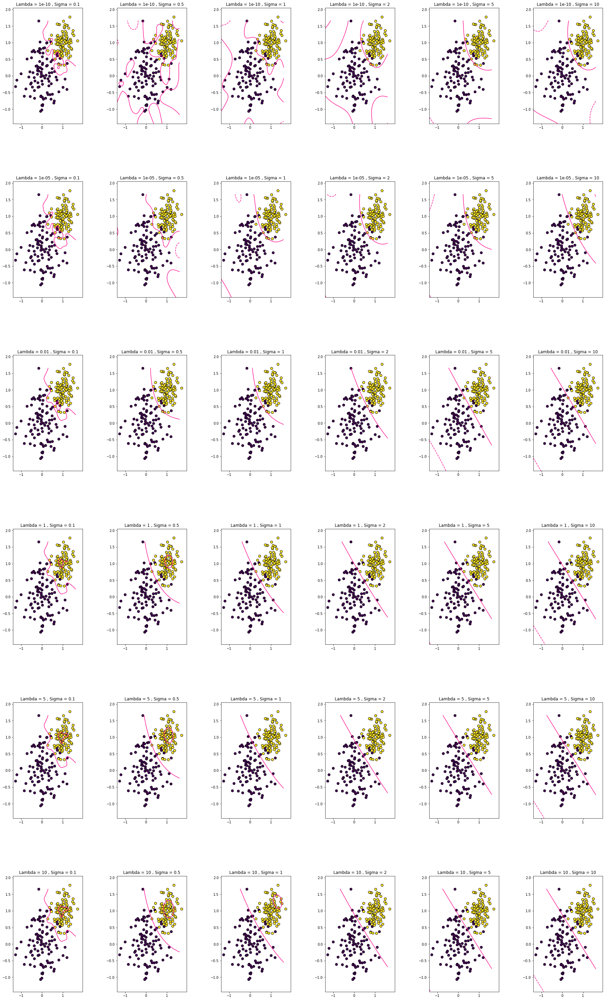

In [4]:
fig, axis = plt.subplots(len(lam_values), len(sigma_values))
i=0
for lam in lam_values:
    j=0
    for sigma in sigma_values:
        c = regularizedKernLSTrain(Xtr, Ytr, 'gaussian', sigma=sigma, lam=lam)
        axis[i, j].set_title("Lambda = %s , Sigma = %s" % (lam, sigma))
        separatingFKernRLS(c, Xtr, Ytr, 'gaussian', sigma, Xts, axis[i, j])
        j=j+1
    i=i+1
fig.subplots_adjust(top=5,bottom=-5,left=-2,right=2, hspace=0.5, wspace=0.5)



Observations for exercise 1C:
First of all, we have to recall that a kernel expresses a measure of similarity between vectors. In this case, we are using a Gaussian kernel to compute the kernel matrix in KRLS.
We can see that, for a larger sigma, the separating function tends to be flexible and smooth: it tends to make some wrong predictions, but avoids the hazard of overfitting. For a smaller sigma, the decision boundary tends to be strict and sharp, therefore it is in contrast to the former situation: it tends to overfit. We in fact recall that the equation for the Gaussian kernel has the following shape:

<img src="gaussian_kernel.png">


As we can see for the equation of kernel function showed above: sigma plays a role to be an amplifier of the distance between x and x'. If the distance between x and x' is much larger than sigma, the kernel function tends to be zero. Thus, if the sigma is very small, only the x within a certain distance can affect the predicting point. In other words, smaller sigma tends to make a local classifier, larger sigma tends to make a much more general classifier. 

As for the variance and bias explanation, smaller sigma tends to be less bias and more variance while larger sigma tends to be less variance and more bias.

We can observe the described behaviour in the plots provided in this exercise. Moreover, we can also say that it is like we have a "dual way" of adding bias and regularization to the model: we recall that, in case we are employing a single parameter tuning in least squares, if lambda gets too large then the separating function would start to be completely flat and parallel to the x-axis, for instance, and would "average out" all the data instead of cutting through it, whereas if lambda is too small we would overfit to the training data. In this case, instead, two parameters (sigma and lambda) balance each other: if sigma is too small, it means that the couples of points which are far away from each other matter less in determining the shape of the separating function, which could be way more wiggled (overfitting), that is to say, it would pass exactly through many of the points of the dataset in a non-linear way. By keeping sigma small and increasing lambda, we can mitigate this effect of overfitting: we allow more missclassified samples, but the separating function still tries to stay as close as possible to the exact non linear separation between the two blobs of points, because sigma is still small, therefore we are employing a model which is more likely to perform well for future samples, because for instance we are miss-predicting on purpose many purple outliers.  If we instead increase sigma and keep lambda fixed, then basing on the explanations provided so far about the Gaussian kernel, we can observe that the model becomes simpler with respect to the shape of the separating function, because the reach of the kernel increases. If we increase both sigma and lambda, then we are balancing the amount of miss-predicted samples, the complexity of the model and the shape of the separating function:the function will be more and more "flexed" as we increase sigma and bend less and less, but once we start increasing lambda, the separating function will resemble more a straight line, because the dataset under analysis is almost perfectly linearly separable and therefore for such a line may be likely to miss-predict on purpose points of the two blobs which are near each other. In general, for Gaussian kernels optimal values for pairs of sigma and lambda can be obtained by looking at a "diagonal" of parameters: an intuition from an example regarding the RBF kernel in SVMs can be found at https://scikit-learn.org/stable/auto_examples/svm/plot_rbf_parameters.html.

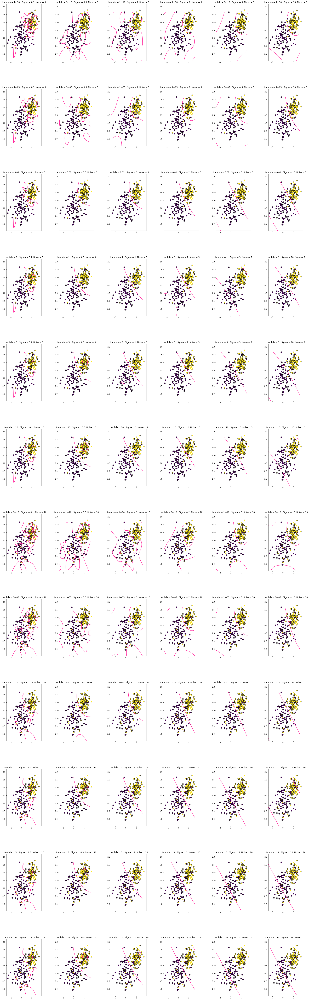

In [5]:
noise_percentages = [5, 10]
fig, axis = plt.subplots(len(lam_values) * len(noise_percentages), len(sigma_values))
i = 0
for noise_perc in noise_percentages:
    Ytr_noisy = flipLabels(Ytr, noise_perc)
    for lam in lam_values:
        j=0
        for sigma in sigma_values:
            c = regularizedKernLSTrain(Xtr, Ytr_noisy, 'gaussian', sigma=sigma, lam=lam)
            axis[i, j].set_title("Lambda = %s , Sigma = %s, Noise = %s" % (lam, sigma, noise_perc))
            separatingFKernRLS(c, Xtr, Ytr_noisy, 'gaussian', sigma, Xts, axis[i, j])
            j=j+1
        i=i+1
fig.subplots_adjust(top=10,bottom=-10,left=-2,right=2, hspace=0.5, wspace=0.5)


General observations for exercise 1D:
With respect to what we have already observed for exercise 1C, we can notice that the effect of increasing noise in our data affects significantly the resulting separating function: when sigma is small and we increase the value of lambda, we overfit to noisy data, and this effect can be observed more and more as we increase the amount of noise in the dataset, especially when lambda is small. In general, the results are more or less aligned with what we have observed in the previous exercise, with the difference that, depending on the position and on the amount of noisy points in the dataset, we may draw arbitrary complex or trivially simple boundaries. For instance, in case we have too much noise in our dataset (10%), we can notice that, by fixing sigma with the maximum value of our kernel parameter list and by increasing progressively lambda, the degree of regularization provided to the problem increases, with the consequence that more and more samples can be miss-predicted, and therefore the separating function ends up cutting in the middle one of the two blobs, even if in that case the prediction performance would be awful. From this point, by either decreasing lambda or sigma, we can make the model less linear on the plane and therefore predict better even in presence of 10% of noise. 

In general, we recall that kernels can be used to deal with datasets which are not perfectly linearly separable, and for example to classify linearly points in higher dimensions, therefore we must be careful when using kernels on noisy datasets, because we may not be able to generalize well for future samples: the added degree of freedom in tuning the parameters may be advantageous or not. If we also think that the dataset we are dealing with is linearly separable, then we shouldn't resort to use non-linear kernels in the first place.

To resume what has been observed in the previous cells, we can therefore conclude that while sigma makes the shape of the boundary arbitrarily wiggled or flexed, the use of lambda makes sure that we deal with noise appropriately even if the complexity of the kernel model would allow us to fit well noisy data. The right combination of the two parameters gives us the best classification/regression performance.


In [6]:
Xtr, Ytr, Xts, Yts = two_moons(100, 10)

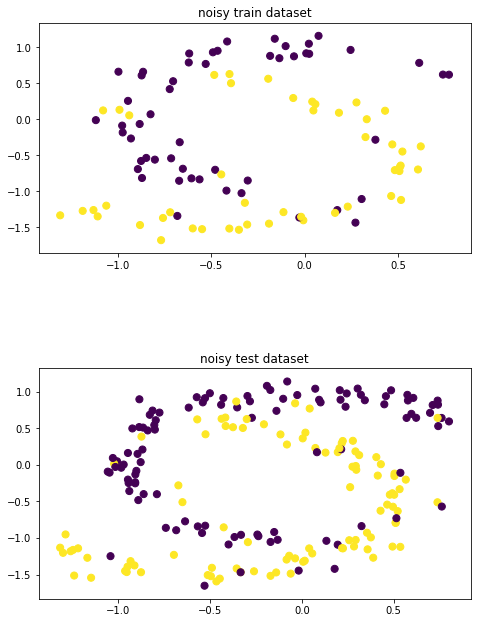

In [7]:
fig, axs = plt.subplots(2, 1)
axs[0].scatter(Xtr[:, 0], Xtr[:, 1], s=50, c=Ytr)
axs[0].set_title('noisy train dataset')
axs[1].scatter(Xts[:, 0], Xts[:, 1], s=50, c=Yts)
axs[1].set_title('noisy test dataset')
fig.tight_layout()
fig.subplots_adjust(top=1,bottom=-1,left=-0.5,right=0.5, hspace=0.5, wspace=0.5)

Exercise 1.E

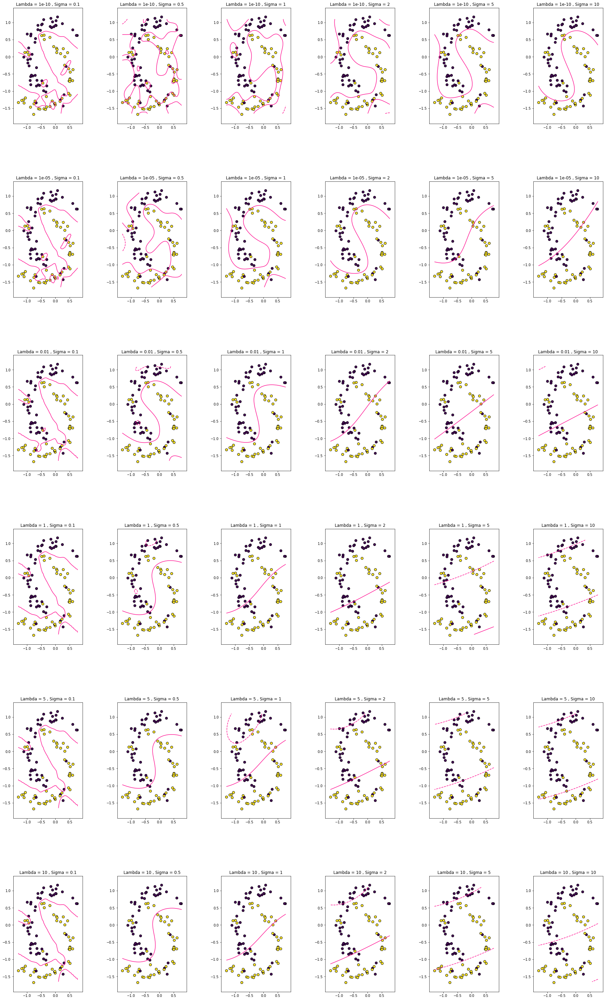

In [8]:
fig, axis = plt.subplots(len(lam_values), len(sigma_values))
i=0
for lam in lam_values:
    j=0
    for sigma in sigma_values:
        c = regularizedKernLSTrain(Xtr, Ytr, 'gaussian', sigma=sigma, lam=lam)
        axis[i, j].set_title("Lambda = %s , Sigma = %s" % (lam, sigma))
        separatingFKernRLS(c, Xtr, Ytr, 'gaussian', sigma, Xts, axis[i, j])
        j=j+1
    i=i+1
fig.subplots_adjust(top=5,bottom=-5,left=-2,right=2, hspace=0.5, wspace=0.5)



Exercise 1.F

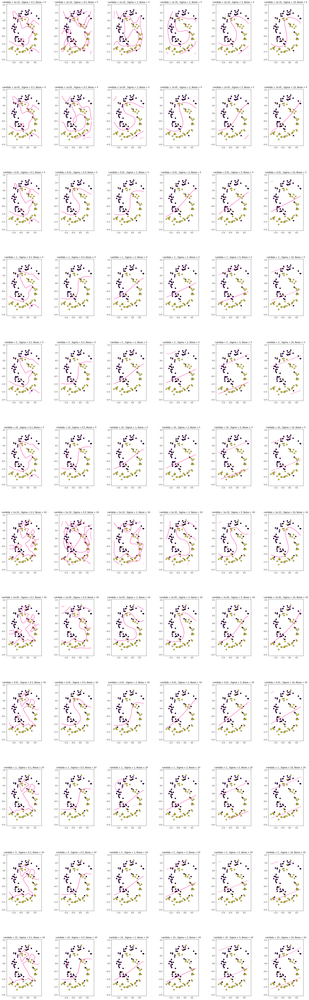

In [9]:
Xtr, Ytr, Xts, Yts = two_moons(100, 0)
noise_percentages = [5, 10]
fig, axis = plt.subplots(len(lam_values) * len(noise_percentages), len(sigma_values))
i = 0
for noise_perc in noise_percentages:
    Ytr_noisy = flipLabels(Ytr, noise_perc)
    for lam in lam_values:
        j=0
        for sigma in sigma_values:
            c = regularizedKernLSTrain(Xtr, Ytr_noisy, 'gaussian', sigma=sigma, lam=lam)
            axis[i, j].set_title("Lambda = %s , Sigma = %s, Noise = %s" % (lam, sigma, noise_perc))
            separatingFKernRLS(c, Xtr, Ytr_noisy, 'gaussian', sigma, Xts, axis[i, j])
            j=j+1
        i=i+1
fig.subplots_adjust(top=10,bottom=-10,left=-2,right=2, hspace=0.5, wspace=0.5)


For what concerns the exercises 1.E and 1.F, the same observations made respectively for 1.C and 1.D hold.

Exercise 2

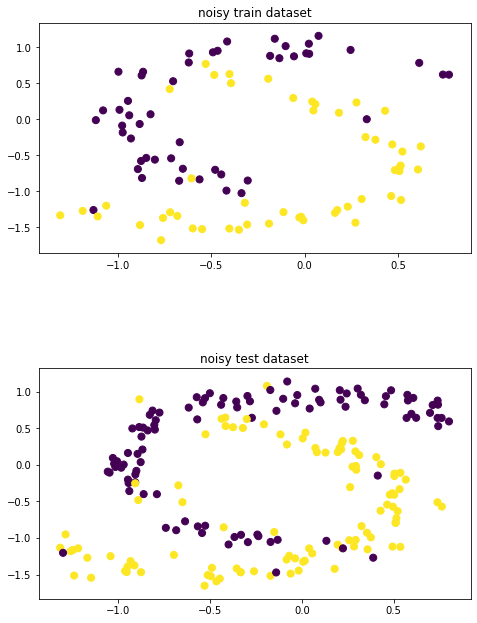

In [10]:
Xtr, Ytr, Xts, Yts = two_moons(100, 5)
fig, axs = plt.subplots(2, 1)
axs[0].scatter(Xtr[:, 0], Xtr[:, 1], s=50, c=Ytr)
axs[0].set_title('noisy train dataset')
axs[1].scatter(Xts[:, 0], Xts[:, 1], s=50, c=Yts)
axs[1].set_title('noisy test dataset')
fig.tight_layout()
fig.subplots_adjust(top=1,bottom=-1,left=-0.5,right=0.5, hspace=0.5, wspace=0.5)

In [11]:
kerpar_list = [0.5]
lam_list = [10, 7, 5, 2, 1, 0.7, 0.5, 0.3, 0.2, 0.1, 0.05, 0.02, 0.01, 0.005 , 0.002 , 0.001 ,0.0005, 0.0002 , 0.0001 , 0.00001 , 0.000001]
nrip=5
perc = 50

In [12]:
help(holdoutCVKernRLS)

Help on function holdoutCVKernRLS in module holdoutCVKernRLS:

holdoutCVKernRLS(x, y, perc, nrip, kernel, lam_list, kerpar_list)
    Input:
    xtr: the training examples
    ytr: the training labels
    kernel: the kernel function (see KernelMatrix documentation).
    perc: percentage of the dataset to be used for validation, must be in range [1,100]
    nrip: number of repetitions of the test for each couple of parameters
    lam_list: list of regularization parameters
        for example intlambda = np.array([5,2,1,0.7,0.5,0.3,0.2,0.1, 0.05, 0.02, 0.01, 0.005, 0.002, 0.001, 0.0005, 0.0002, 0.0001,0.00001,0.000001])
    kerpar_list: list of kernel parameters
        for example intkerpar = np.array([10,7,5,4,3,2.5,2.0,1.5,1.0,0.7,0.5,0.3,0.2,0.1, 0.05, 0.03,0.02, 0.01])
    
    Returns:
    l, s: the couple of lambda and kernel parameter that minimize the median of the validation error
    vm, vs: median and variance of the validation error for each couple of parameters
    tm, ts: 

Exercise 2.A

Best value(s) for the regularization parameter lambda :  [0.02]


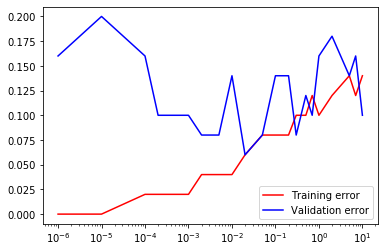

In [13]:
l, s, Vm, Vs, Tm, Ts = holdoutCVKernRLS(Xtr, Ytr, perc, nrip, 'gaussian', lam_list, kerpar_list)
fig, axs = plt.subplots(1, 1)
plt.semilogx(lam_list , Tm, 'r')
plt.semilogx(lam_list , Vm, 'b')
plt.legend(['Training error', 'Validation error'])
print ("Best value(s) for the regularization parameter lambda : ", l)

Exercise 2.B

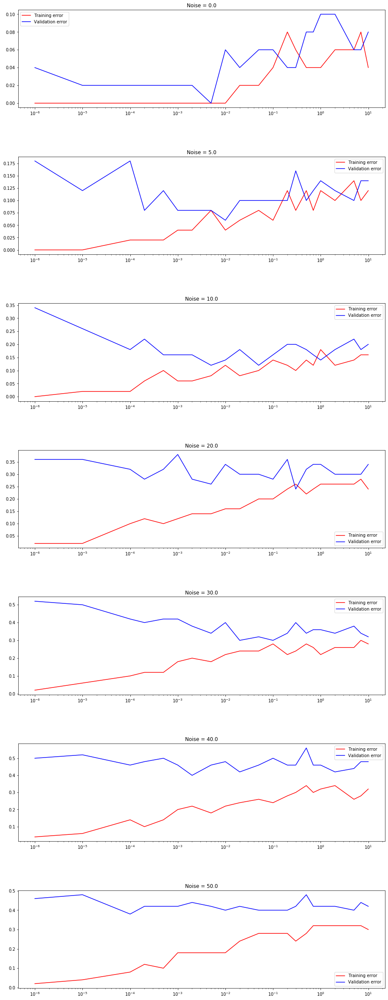

In [14]:
n_samples = 100
Xtr, Ytr, Xts, Yts = two_moons(n_samples, 0)
noise_percentages = np.array([0.0, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5])*100
fig, axs = plt.subplots(noise_percentages.shape[0], 1)
axis_iterator = iter(axs)
for noise_perc in noise_percentages:
    if (noise_perc == 0.0):
        Ytr_noisy = Ytr
    else:
        Ytr_noisy = flipLabels(Ytr, noise_perc)
    l, s, Vm, Vs, Tm, Ts = holdoutCVKernRLS(Xtr, Ytr_noisy, perc, nrip, 'gaussian', lam_list, kerpar_list)
    ax = next(axis_iterator)
    ax.set_title("Noise = %s" % noise_perc)
    ax.semilogx(lam_list , Tm, 'r')
    ax.semilogx(lam_list , Vm, 'b')
    ax.legend(['Training error', 'Validation error'])
    
fig.subplots_adjust(top=4,bottom=-4,left=-1,right=1, hspace=0.5, wspace=0.5)


Observations for exercise 2.B: To perform this experiment, we are keeping sigma fixed (equal to 0.5) and increasing the value of lambda. The x-axis represents the value for lambda. The general behaviour that we can observe is the following: as we increase the amount of noise, both values for the training and test error increase; for small values of lambda, the training error is far smaller than the test error, because we are not providing any degree of regularization to the model. Then, as we increase the value of lambda, if the problem is not ill posed (too much noise) we reach a "significant" minimum for the test error, and also training and test error do intersect in the plot. These observations are noticeable especially if we look at the plots associated to the values of noise 0, 5 and 10, where the test error has still a reasonable value with respect to the other plots. Moreover, the plots corresponding to the values of noise 0, 5 and 10 still more or less recall the bias-variance trade-off: after the test error reaches a minimum and meets the training error, it grows again as the value of lambda gets bigger, and starts to be more or less at the same level of the training error when lambda equals 10; it will again be above the training error for larger lambdas. If we instead look at the plots corresponding to values of noise 20, 30, 40, 50, we can notice that the test error curve increases its distance from the training error curve. This happens because, no matter the value of lambda we are adoperating, we end up with a model built on a problem which is too much ill posed: the data we have at hand does not correspond to the "true" distribution and therefore we are not able to generalize to future samples.

Exercise 2.C

Best value(s) for the kernel parameter sigma:  [2.]


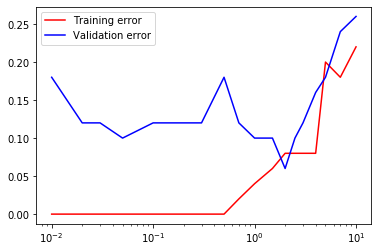

In [15]:
kerpar_list = [10, 7, 5, 4, 3, 2.5, 2.0, 1.5, 1.0, 0.7, 0.5, 0.3, 0.2, 0.1, 0.05 , 0.03 , 0.02 , 0.01]
lam_list = [0.00001]
nrip=5
perc=50
Xtr, Ytr, Xts, Yts = two_moons(100, 5)
l, s, Vm, Vs, Tm, Ts = holdoutCVKernRLS(Xtr, Ytr, perc, nrip, 'gaussian', lam_list, kerpar_list)
fig, axs = plt.subplots(1, 1)
plt.semilogx(kerpar_list, Tm.flatten(), 'r')
plt.semilogx(kerpar_list, Vm.flatten(), 'b')
plt.legend(['Training error', 'Validation error'])
print ("Best value(s) for the kernel parameter sigma: ", s)

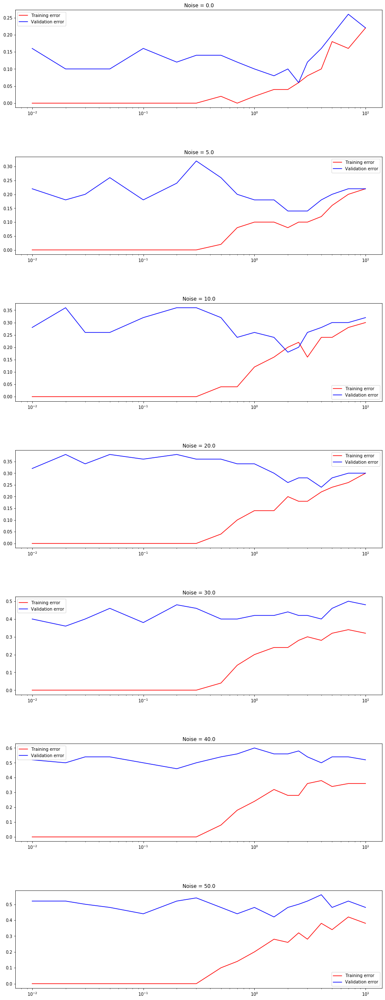

In [16]:
noise_percentages = np.array([0.0, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5])*100
fig, axs = plt.subplots(noise_percentages.shape[0], 1)
axis_iterator = iter(axs)
for noise_perc in noise_percentages: 
    if (noise_perc == 0.0):
        Ytr_noisy = Ytr
    else:
        Ytr_noisy = flipLabels(Ytr, noise_perc)
    l, s, Vm, Vs, Tm, Ts = holdoutCVKernRLS(Xtr, Ytr_noisy, perc, nrip, 'gaussian', lam_list, kerpar_list)
    ax = next(axis_iterator)
    ax.set_title("Noise = %s" % noise_perc)
    ax.semilogx(kerpar_list , Tm.flatten(), 'r')
    ax.semilogx(kerpar_list , Vm.flatten(), 'b')
    ax.legend(['Training error', 'Validation error'])
    
fig.subplots_adjust(top=4,bottom=-4,left=-1,right=1, hspace=0.5, wspace=0.5)


Observations for exercise 2.D: similar to the ones provided for exercise 2.B for what concerns the trend of the training and test error. This time, the values on the x-axis are for the parameter sigma. In this case, the kernel parameter sigma provides some sort of "regularization" to the problem. This kind of "regularization" works in the following way: the greater the value of sigma, the greater will be the influence of couples of points which are far away from each other when we draw the separating function. If more and more points partecipate in exercising such an influence, then the separating function will be more and more "flexed", until the extreme case, in which the function will become completely flat, this depending also on the initial value provided for lambda. In general, neither too low nor too high values for sigma should be used, and we should look for the best lambda AND sigma.

We notice the same behaviour as in 2.B: as we increase the amount of noise, the test error starts to be far above the training error (the two curves increase the spacing between them).
The difference is that, in this case, we are not explicitly penalizing the empirical risk with lambda as per the formula of least squares: we are simply changing the shape of the function for a fixed lambda so that it fits data in a less complex or more complex way, basing on the formula of the gaussian kernel, which serves as an affinity measure for the samples. Moreover, it seems that in this case we may be more influenced by noisy points and outliers, because a far reach for the gaussian kernels (large sigma) would mean that ouliers would be counted when flexing the separating function.

Exercise 2.E

Best value(s) for the regularization parameter lambda :  [1.e-03 5.e-04 1.e-06]
Best value(s) for the kernel parameter sigma:  [1 1 3]
Best pair(s) of parameters :  [(0.001, 1), (0.0005, 1), (1e-06, 3)]


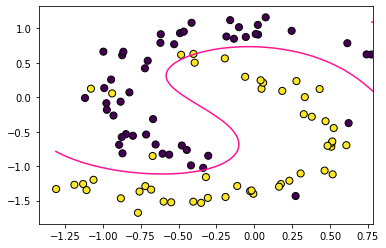

In [17]:
Xtr, Ytr, Xts, Yts = two_moons(100, 5)
kerpar_list = [1, 2, 3, 4, 5, 6, 7, 8, 9]
lam_list = [5, 2, 1, 0.7, 0.5, 0.3, 0.2, 0.1, 0.05, 0.02, 0.01, 0.005, 0.002 , 0.001 , 0.0005 , 0.0002 , 0.0001 ,0.00001 ,0.000001]
nrip=5
perc = 50
l, s, Vm, Vs, Tm, Ts = holdoutCVKernRLS(Xtr, Ytr, perc, nrip, 'gaussian', lam_list, kerpar_list)

parameter_pairs = []
if (len(l) == len(s)):
    for i in range(len(l)):
        parameter_pairs.append((l[i], s[i]))
else:
    parameter_pairs = [(best_lam, best_ker) for best_lam in l for best_ker in s]
    
n_pairs = len(parameter_pairs)
print ("Best value(s) for the regularization parameter lambda : ", l)
print ("Best value(s) for the kernel parameter sigma: ", s)
print ("Best pair(s) of parameters : ", parameter_pairs)

fig, axs = plt.subplots(1, 1)

if not isinstance(axs, np.ndarray):
    axis_iterator = iter([axs])
else: 
    axis_iterator = iter(axs)

mid =  int(np.trunc((n_pairs)/2.0)) 
if (len(l) == len(s)):
    best_pair = parameter_pairs[mid]
else:
    best_pair = (np.median(l), np.median(s))
    
c = regularizedKernLSTrain(Xtr, Ytr, 'gaussian', sigma=best_pair[1], lam=best_pair[0])
separatingFKernRLS(c, Xtr, Ytr, 'gaussian', best_pair[1], Xts, axs)
    


Exercise 2.F

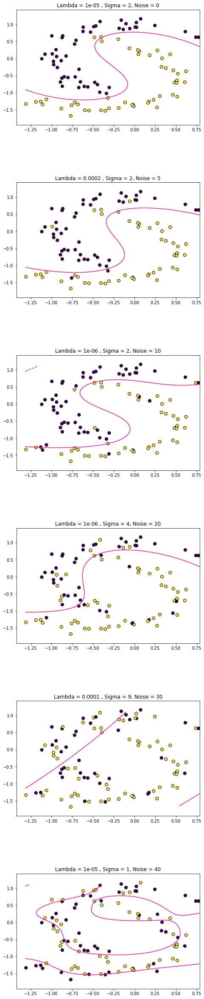

In [18]:
noise_percentages = np.array([0, 5, 10, 20, 30, 40])
Xtr, Ytr, Xts, Yts = two_moons(100, 0)
fig, axs = plt.subplots(noise_percentages.shape[0], 1)
axis_iterator = iter(axs)
for noise_perc in noise_percentages: 
    if (noise_perc == 0):
        Ytr_noisy = Ytr
    else:
        Ytr_noisy = flipLabels(Ytr, noise_perc)
    l, s, Vm, Vs, Tm, Ts = holdoutCVKernRLS(Xtr, Ytr_noisy, perc, nrip, 'gaussian', lam_list, kerpar_list)
        
    parameter_pairs = []
    if (len(l) == len(s)):
        for i in range(len(l)):
            parameter_pairs.append((l[i], s[i]))
    else:
        parameter_pairs = [(best_lam, best_ker) for best_lam in l for best_ker in s]
    n_pairs = len(parameter_pairs)

    mid =  int(np.trunc((n_pairs)/2.0)) 
    if (len(l) == len(s)):
        best_pair = parameter_pairs[mid]
    else:
        best_pair = (np.median(l), np.median(s))
    
    c = regularizedKernLSTrain(Xtr, Ytr_noisy, 'gaussian', sigma=best_pair[1], lam=best_pair[0])
    curr_axis = next(axis_iterator)
    separatingFKernRLS(c, Xtr, Ytr_noisy, 'gaussian', best_pair[1], Xts, curr_axis)
    curr_axis.set_title("Lambda = %s , Sigma = %s, Noise = %s" % (best_pair[0], best_pair[1], noise_perc))


    
fig.subplots_adjust(top=4,bottom=-4,left=-0.5,right=0.5, hspace=0.5, wspace=0.5)


Observations for exercise 2.F: If we build a model on a dataset without noise, or if increase the amount of noise by just 5 % or 10 %, we can notice that the main shape of the separating function remains unchanged, and we usually tend to have the same value for sigma, for instance 2, whereas the values for lambda may vary from 10^-5, 10^-6, 0.0002, because of the growing degree of regularization to be included in the model to face the amount of noise. Once the values of noise reach 20%, 30%, 40%, then models built on the data and the corresponding separating functions start to behave in a completely different way between each other. Depending on what are the noisy points in our dataset, with 20% or 30% of noise we may end up either with some straight lines or with a "flexed" decision boundary (therefore, the lambda and sigma parameter may be increased or decreased accordingly), which is expected, because with 30% of noise we are starting to "lose" the actual shape of the distribution, whereas with 20% we can still see the shape of the two moons. Eventually, when noise reaches 40% then problem starts to be so ill posed that the separating function doesn't make much sense, as long as the data itself, and as a consequence sigma decreases again, because in this case the only way to fit to this kind of data and miss-predict less samples as possible is to draw a complicated boundary.

Exercise 3

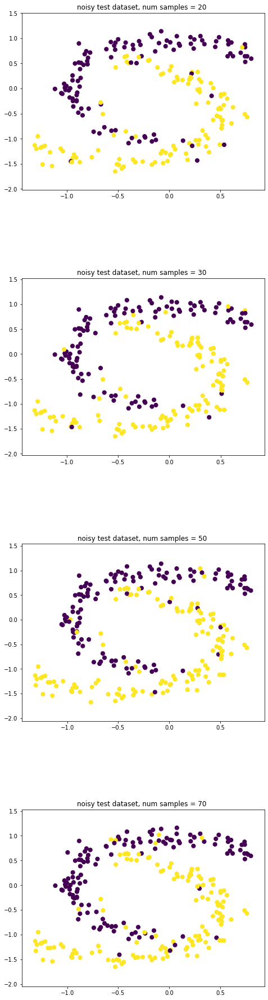

In [19]:
n_samples_vals = [20, 30, 50, 70]
fig, axs = plt.subplots(len(n_samples_vals), 1)
axis_iterator = iter(axs)
for n_samples in n_samples_vals:
    curr_axis = next(axis_iterator)
    Xtr, Ytr, Xts, Yts = two_moons(n_samples, 5)
    curr_axis.scatter(Xtr[:, 0], Xtr[:, 1], s=50, c=Ytr)
    curr_axis.set_title('noisy train dataset, num samples = %s ' % n_samples)
    curr_axis.scatter(Xts[:, 0], Xts[:, 1], s=50, c=Yts)
    curr_axis.set_title('noisy test dataset, num samples = %s ' % n_samples)
fig.subplots_adjust(top=3,bottom=-3,left=-0.5,right=0.5, hspace=0.5, wspace=0.5)


In [20]:
kerpar_list = [0.5]
lam_list = [10, 7, 5, 2, 1, 0.7, 0.5, 0.3, 0.2, 0.1, 0.05, 0.02, 0.01, 0.005 , 0.002 , 0.001 ,0.0005, 0.0002 , 0.0001 , 0.00001 , 0.000001]
nrip=5
perc = 50

In [21]:
def experiment_2_sep_function(n_samples_vals, noise_percentages, perc, nrip, lam_list, kerpar_list, kernel='gaussian'):
    noise_percentages = np.array(noise_percentages)
    n_samples_vals = np.array(n_samples_vals)
    fig, axs = plt.subplots(n_samples_vals.shape[0] * noise_percentages.shape[0], 1)
    axis_iterator = iter(axs)
    for n_samples in n_samples_vals:
        Xtr, Ytr, Xts, Yts = two_moons(n_samples, 0)
        for noise_perc in noise_percentages:    
            if (noise_perc == 0.0):
                Ytr_noisy = Ytr
            else:
                Ytr_noisy = flipLabels(Ytr, noise_perc)
            l, s, Vm, Vs, Tm, Ts = holdoutCVKernRLS(Xtr, Ytr_noisy, perc, nrip, kernel, lam_list, kerpar_list)

            parameter_pairs = []
            if (len(l) == len(s)):
                for i in range(len(l)):
                    parameter_pairs.append((l[i], s[i]))
            else:
                parameter_pairs = [(best_lam, best_ker) for best_lam in l for best_ker in s]
            n_pairs = len(parameter_pairs)

            mid =  int(np.trunc((n_pairs)/2.0)) 
            if (len(l) == len(s)):
                best_pair = parameter_pairs[mid]
            else:
                best_pair = (np.median(l), np.median(s))

            c = regularizedKernLSTrain(Xtr, Ytr_noisy, kernel, sigma=best_pair[1], lam=best_pair[0])
            curr_axis = next(axis_iterator)
            separatingFKernRLS(c, Xtr, Ytr_noisy, kernel, best_pair[1], Xts, curr_axis)
            curr_axis.set_title("Lambda = %s , Kernel Parameter = %s, Noise = %s, Num samples: %s " % (best_pair[0], best_pair[1], noise_perc, n_samples))
    return fig    
    
def experiment_2_train_test_errors(n_samples_vals, noise_percentages, perc, nrip, lam_list, kerpar_list, choice=True, kernel='gaussian'):
    noise_percentages = np.array(noise_percentages)
    n_samples_vals = np.array(n_samples_vals)
    lam_list = np.array(lam_list)
    kerpar_list = np.array(kerpar_list)
    fig, axs = plt.subplots(n_samples_vals.shape[0] * noise_percentages.shape[0], 1)
    axis_iterator = iter(axs)
    for n_samples in n_samples_vals:
        Xtr, Ytr, Xts, Yts = two_moons(n_samples, 0)
        for noise_perc in noise_percentages: 
            if (noise_perc == 0.0):
                Ytr_noisy = Ytr
            else:
                Ytr_noisy = flipLabels(Ytr, noise_perc)
            l, s, Vm, Vs, Tm, Ts = holdoutCVKernRLS(Xtr, Ytr_noisy, perc, nrip, kernel, lam_list, kerpar_list)
            ax = next(axis_iterator)
            ax.set_title("Noise = %s, Num samples = %s " % (noise_perc, n_samples))
            if (choice):
                ax.semilogx(lam_list , Tm, 'r')
                ax.semilogx(lam_list , Vm, 'b')
            else:
                ax.semilogx(kerpar_list, Tm.flatten(), 'r')
                ax.semilogx(kerpar_list, Vm.flatten(), 'b')
            ax.legend(['Training error', 'Validation error'])
    return fig



In [22]:
kerpar_list = [0.5]
lam_list = [10, 7, 5, 2, 1, 0.7, 0.5, 0.3, 0.2, 0.1, 0.05, 0.02, 0.01, 0.005 , 0.002 , 0.001 ,0.0005, 0.0002 , 0.0001 , 0.00001 , 0.000001]
nrip=5
perc = 50

Exercise 3.A

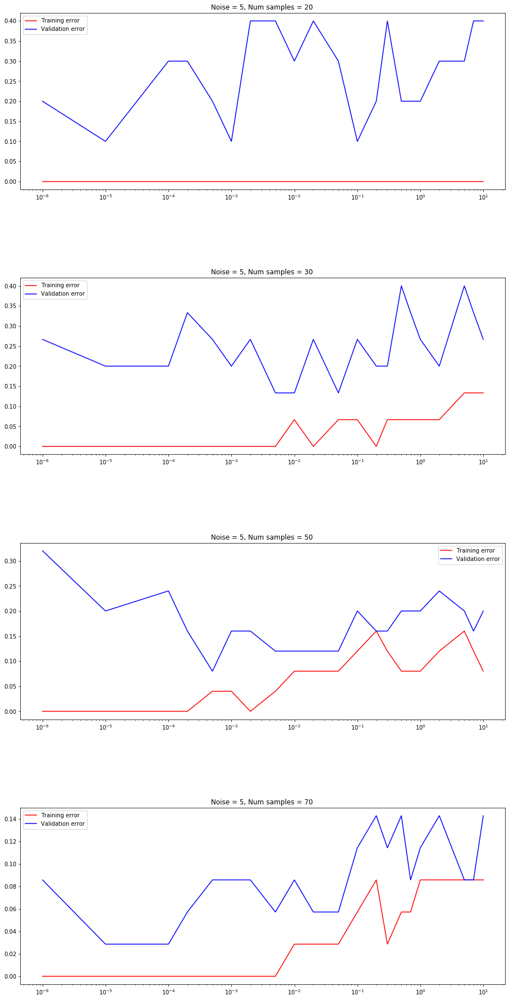

In [23]:
fig = experiment_2_train_test_errors(n_samples_vals, [5], 50, 5, lam_list, kerpar_list, True)
fig.subplots_adjust(top=3,bottom=-3,left=-1,right=1, hspace=0.5, wspace=0.5)


Observations on the above plots:
The cross validation procedure is executed with the following splitting strategy: we perform n random permutations of the dataset, and for each permutation we split 50%/50% the dataset into training and validation sets. Therefore, we can understand that if for instance the number of samples in the dataset is 20, then our training set would contain 10 samples. In that case, we wouldn't be able to generalize to new samples, because a small number of samples is not enough to give to the model the idea of the overall distribution of the data, and therefore, as we can observe in the first plot, the training error is completely flat, whereas the test error is far greater. As we increase the number of samples in the dataset, the test error keeps decreasing and eventually gets closer to the training error. This is expected, since the limit of the expected test error should go to 0 as the number of samples goes to infinity.

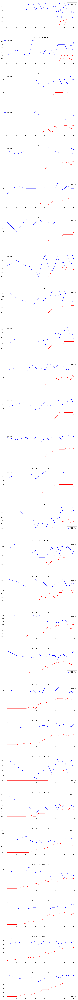

In [24]:
noise_percentages = np.array([0.0, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5])*100
fig = experiment_2_train_test_errors(n_samples_vals, noise_percentages, perc, nrip, lam_list, kerpar_list, choice=True)
fig.subplots_adjust(top=20,bottom=-20,left=-1,right=1, hspace=0.5, wspace=1)


Observations on the above plots: The same observations made for the previous exercise hold. In this case, we have also to add that if we increase the amount of noise in the dataset, then even if the number of samples would be enough to provide us a good classification/regression performance, the problem is again ill posed (too much noise), and therefore we end up with a test error which is almost always greater than the training error.

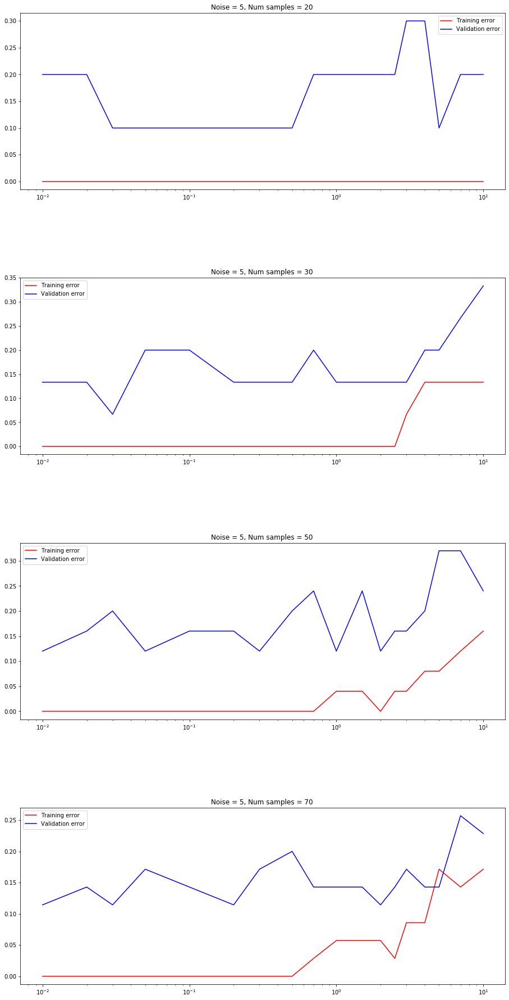

In [25]:
kerpar_list = [10, 7, 5, 4, 3, 2.5, 2.0, 1.5, 1.0, 0.7, 0.5, 0.3, 0.2, 0.1, 0.05 , 0.03 , 0.02 , 0.01]
lam_list = [0.00001]
nrip=5
perc=50

fig = experiment_2_train_test_errors(n_samples_vals, [5], perc, nrip, lam_list, kerpar_list, choice=False)
fig.subplots_adjust(top=3,bottom=-3,left=-1,right=1, hspace=0.5, wspace=1)


In the above plots, we considered the same experiment as one performed before, but this time using values of kernel parameter for the x-axis. We can make similar observations to the ones made for the previous experiment: as we increase the number of samples in the dataset, the spacing between the two curves of training and test error gets smaller and smaller. By increasing the number of samples, we are again adjusting the uncertainty due to the lack of knowledge for small training sets in the cross validation procedure.

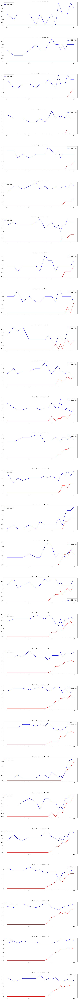

In [26]:
noise_percentages = np.array([0.0, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5])*100
fig = experiment_2_train_test_errors(n_samples_vals, noise_percentages, perc, nrip, lam_list, kerpar_list, choice=False)
fig.subplots_adjust(top=20,bottom=-20,left=-1,right=1, hspace=0.5, wspace=1)


    


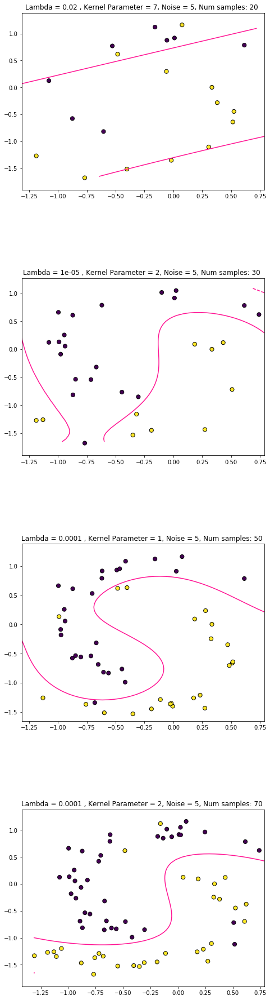

In [27]:
kerpar_list = [1, 2, 3, 4, 5, 6, 7, 8, 9]
lam_list = [5, 2, 1, 0.7, 0.5, 0.3, 0.2, 0.1, 0.05, 0.02, 0.01, 0.005, 0.002 , 0.001 , 0.0005 , 0.0002 , 0.0001 ,0.00001 ,0.000001]

fig = experiment_2_sep_function(n_samples_vals, [5], 50, 5, lam_list, kerpar_list)
fig.subplots_adjust(top=3,bottom=-3,left=-0.5,right=0.5, hspace=0.5, wspace=0.5)


In this case, we are dealing with a dataset which is not perfectly linearly separable. The shape of such dataset is more or less "enhanced" with respect to the original distribution depending on the number of samples and on the amount of noise, therefore we may end up with different parameters and boundaries. We can notice that, when the number of samples is small, for instance 20, then the separating function may be drawn using one or more straight lines, because the original shape of the dataset is "lost" (lack of knowledge, but this may also be due to the amount of noise), therefore something which resembles a "linear" model may be better in that case, whereas as we increase the number of samples the shape of the boundary between the classes starts to be more "flexed" and follows the original separation of the two moons.
Therefore, for such shapes of the separating functions, we would expect to see larger values of lambda and sigma for lower numbers of samples (because they usually correspond to straight lines) and smaller values of lambda and sigma for greater numbers of samples.
Again, I recall that good values for lambda and sigma can be found by looking at a "diagonal" of parameters, in analogy with what has been written for the SVM at the following link: 
https://scikit-learn.org/stable/auto_examples/svm/plot_rbf_parameters.html


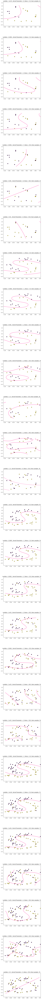

In [28]:
kerpar_list = [1, 2, 3, 4, 5, 6, 7, 8, 9]
lam_list = [5, 2, 1, 0.7, 0.5, 0.3, 0.2, 0.1, 0.05, 0.02, 0.01, 0.005, 0.002 , 0.001 , 0.0005 , 0.0002 , 0.0001 ,0.00001 ,0.000001]

fig = experiment_2_sep_function(n_samples_vals, noise_percentages, 50, 5, lam_list, kerpar_list)
fig.subplots_adjust(top=20,bottom=-20,left=-0.5,right=0.5, hspace=0.5, wspace=0.5)


For the above plots, similar observations with respect to what has been done before can be made. The only difference is that this time we are changing the number of samples.

Exercise 3.B

In [29]:
Xtr, Ytr = MixGauss(means=[[0,0],[1,1]], sigmas=[0.5, 0.3], n=100)
Xts, Yts = MixGauss(means=[[0,0],[1,1]], sigmas=[0.5, 0.3], n=100)
Ytr = 2*np.mod(Ytr, 2)-1
Yts = 2*np.mod(Yts, 2)-1

In [30]:
t_values = [1, 2, 5, 7, 10]
lam_values = [1e-10, 1e-5, 1e-2, 1, 2, 5, 7, 10]

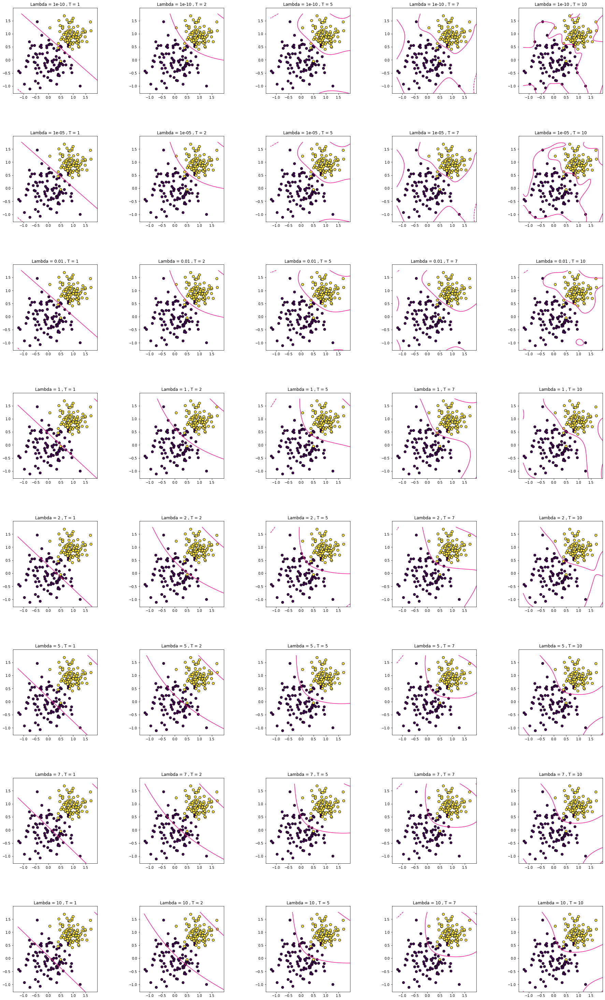

In [31]:
fig, axis = plt.subplots(len(lam_values), len(t_values))
i=0
for lam in lam_values:
    j=0
    for t in t_values:
        c = regularizedKernLSTrain(Xtr, Ytr, 'polynomial', sigma=t, lam=lam)
        axis[i, j].set_title("Lambda = %s , T = %s" % (lam, t))
        separatingFKernRLS(c, Xtr, Ytr, 'polynomial', t, Xts, axis[i, j])
        j=j+1
    i=i+1
fig.subplots_adjust(top=5,bottom=-5,left=-2,right=2, hspace=0.5, wspace=0.5)



When using a polynomial kernel, the separating function changes in the following way: if we fix T=1 and we increase the value of lambda, we are resorting to a plain linear model, in which the power of the kernel is set to 1. We are in fact computing the matrix $XX^T$ and then adding a +1 as a bias term. Therefore, we can notice that as we increase the value of lambda the separating function gets translated in the direction corresponding to one of the two blobs of points, because again, the bigger lambda, the more "relaxed" the model is with respect to the fitting of the data. If we increase the power T, we can notice that the produced separating functions are not linear anymore on the plane, but the effect of increasing lambda remains more or less the same: the area of the separating function which is associated to the yellow class gets larger and larger, and therefore we are failing on purpose some predictions to better generalize to new samples. 

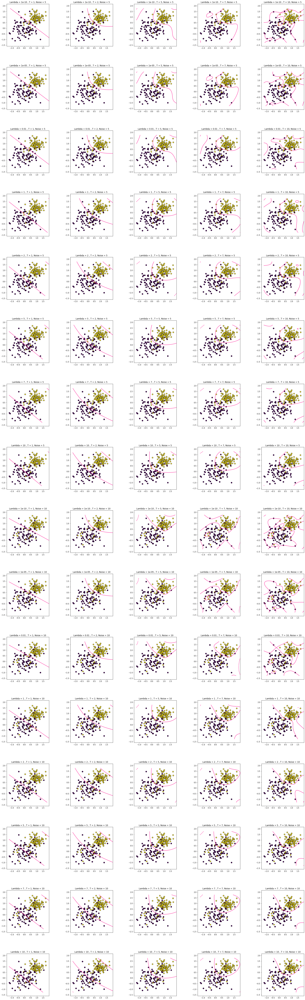

In [32]:
noise_percentages = [5, 10]
fig, axis = plt.subplots(len(lam_values) * len(noise_percentages), len(t_values))
i = 0
for noise_perc in noise_percentages:
    Ytr_noisy = flipLabels(Ytr, noise_perc)
    for lam in lam_values:
        j=0
        for t in t_values:
            c = regularizedKernLSTrain(Xtr, Ytr_noisy, 'polynomial', sigma=t, lam=lam)
            axis[i, j].set_title("Lambda = %s , T = %s, Noise = %s" % (lam, t, noise_perc))
            separatingFKernRLS(c, Xtr, Ytr_noisy, 'polynomial', t, Xts, axis[i, j])
            j=j+1
        i=i+1
fig.subplots_adjust(top=10,bottom=-10,left=-2,right=2, hspace=0.5, wspace=0.5)


We can make the same observations as the ones performed in the previous exercise. In this case, we have also to add that the number of points incorrectly predicted of the two classes can grow proportionally to the amount of noise when increasing the values of lambda. We can also make further observations with respect to the ones made before: by increasing the value of T, in general, as per every feature map, we are mapping our dataset in higher dimensions, and the dimensionality of the mapped features grows with T, therefore the larger T, the more complex a model will be. We can therefore have the intuition that with large values of T, we could exactly predict the values of all possible points of our dataset, but the test error would be greater, because we would overfit, maybe to noisy data.
An interesting observation is also the following: with polynomial degrees greater than 2, we are very likely to overfit when using a SVM in natural language processing, for example, as we can see at the following link https://en.wikipedia.org/wiki/Polynomial_kernel 

In [33]:
Xtr, Ytr, Xts, Yts = two_moons(100, 0)

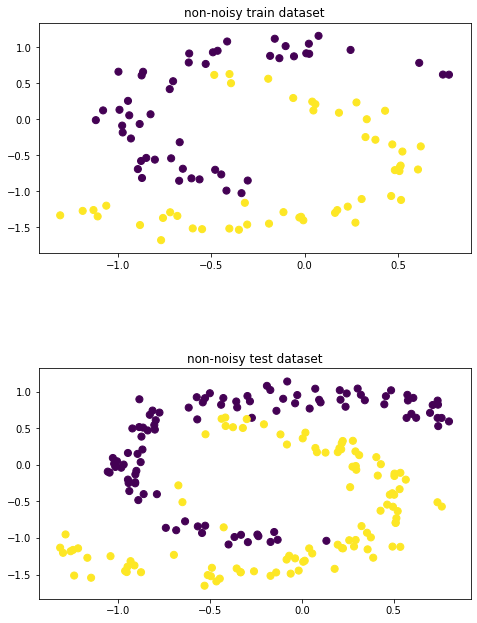

In [34]:
fig, axs = plt.subplots(2, 1)
axs[0].scatter(Xtr[:, 0], Xtr[:, 1], s=50, c=Ytr)
axs[0].set_title('non-noisy train dataset')
axs[1].scatter(Xts[:, 0], Xts[:, 1], s=50, c=Yts)
axs[1].set_title('non-noisy test dataset')
fig.tight_layout()
fig.subplots_adjust(top=1,bottom=-1,left=-0.5,right=0.5, hspace=0.5, wspace=0.5)

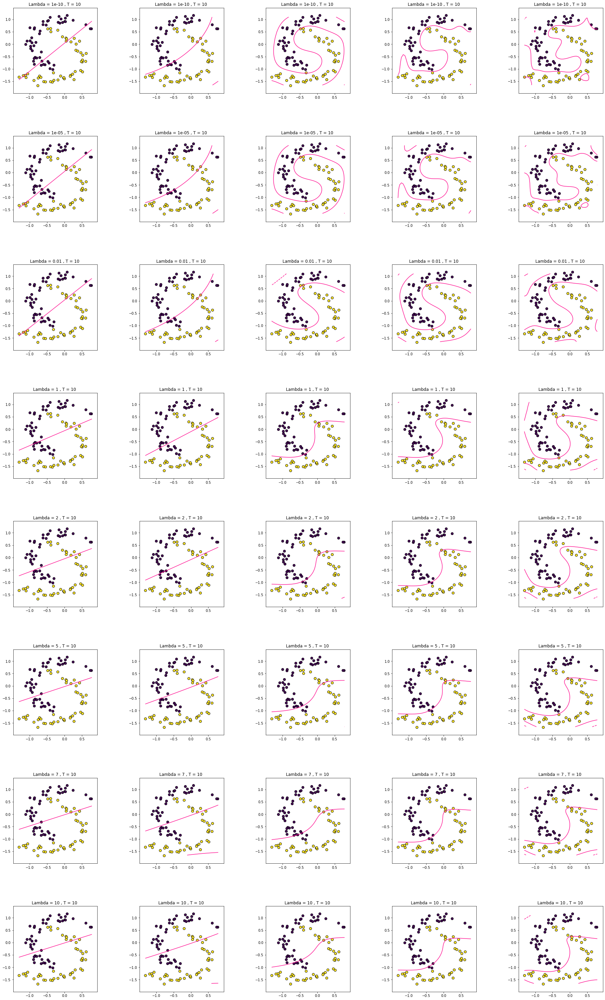

In [35]:
fig, axis = plt.subplots(len(lam_values), len(t_values))
i=0
for lam in lam_values:
    j=0
    for t in t_values:
        c = regularizedKernLSTrain(Xtr, Ytr, 'polynomial', sigma=t, lam=lam)
        axis[i, j].set_title("Lambda = %s , T = %s " % (lam, sigma))
        separatingFKernRLS(c, Xtr, Ytr, 'polynomial', t , Xts, axis[i, j])
        j=j+1
    i=i+1
fig.subplots_adjust(top=5,bottom=-5,left=-2,right=2, hspace=0.5, wspace=0.5)



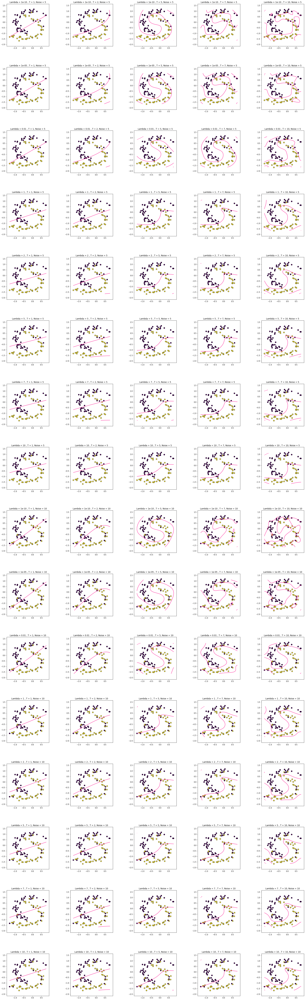

In [36]:
noise_percentages = [5, 10]
fig, axis = plt.subplots(len(lam_values) * len(noise_percentages), len(t_values))
i = 0
for noise_perc in noise_percentages:
    Ytr_noisy = flipLabels(Ytr, noise_perc)
    for lam in lam_values:
        j=0
        for t in t_values:
            c = regularizedKernLSTrain(Xtr, Ytr_noisy, 'polynomial', sigma=t, lam=lam)
            axis[i, j].set_title("Lambda = %s , T = %s, Noise = %s" % (lam, t, noise_perc))
            separatingFKernRLS(c, Xtr, Ytr_noisy, 'polynomial', t, Xts, axis[i, j])
            j=j+1
        i=i+1
fig.subplots_adjust(top=10,bottom=-10,left=-2,right=2, hspace=0.5, wspace=0.5)


For the exercises of 3.B regarding the experiments on the "two moons" dataset, the same observations made for the Gaussian blobs can be made.

Exercise 3.C:

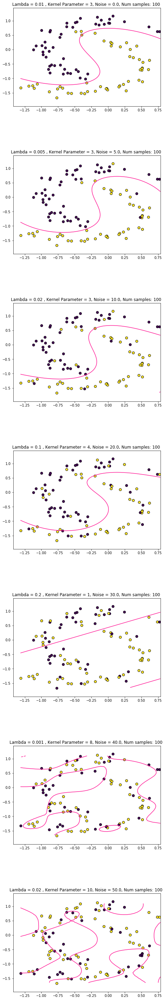

In [37]:
noise_percentages = np.array([0.0, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5])*100
kerpar_list = [1, 2, 3, 4, 5, 6, 7, 8, 9,10]
lam_list = [10, 7, 5, 2, 1, 0.7, 0.5, 0.3, 0.2, 0.1, 0.05, 0.02, 0.01, 0.005 , 0.002 , 0.001 , 0.0005 , 0.0002 , 0.0001 ,0.00001 ,0.000001]
fig = experiment_2_sep_function([100], noise_percentages, 50, 5, lam_list, kerpar_list, 'polynomial')
fig.subplots_adjust(top=5,bottom=-5,left=-0.5,right=0.5, hspace=0.5, wspace=0.5)


To determine the best value for the parameter T of the polynomial kernel, we may look just at the plots reported above which correspond to reasonable values of noise, for instance 0%, 5%, 10%, 20%. We can guess that the best value for the parameter T of the polynomial kernel could be T=3. I choose T=3 because it is the best value for the kernel parameter which appears several times in the results; also, if we look at the plots corresponding to larger values of noise, we can notice that kernel parameter values could be either too low (T=1) or too high (T=8), because in these cases the datasets have so much noise that the resulting models are either too complex (noise=50%) or too relaxed (noise=30%). Moreover, if the dataset has 0%, 5% or 10% of noise, we could still obtain a decent test error by using a linear model, since the dataset is not perfectly linearly separable, but almost, therefore we can guess that the solution to the problem may not be so far from T=1. We can also recall the information reported at the following link about the drawbacks of using degrees greater than 2 when dealing with a polymonial kernel : https://en.wikipedia.org/wiki/Polynomial_kernel.

Exercise 3.D

(70, 70)
K shape (70, 70)
(70, 70)
K shape (70, 70)
(70, 70)
K shape (70, 70)
(70, 70)
K shape (70, 70)
(70, 70)
K shape (70, 70)
(70, 70)
K shape (70, 70)
(70, 70)
K shape (70, 70)
(70, 70)
K shape (70, 70)
(70, 70)
K shape (70, 70)
(70, 70)
K shape (70, 70)
(70, 70)
K shape (70, 70)
(70, 70)
K shape (70, 70)
(70, 70)
K shape (70, 70)
(70, 70)
K shape (70, 70)
(70, 70)
K shape (70, 70)
(70, 70)
K shape (70, 70)
(70, 70)
K shape (70, 70)
(70, 70)
K shape (70, 70)
(70, 70)
K shape (70, 70)
(70, 70)
K shape (70, 70)


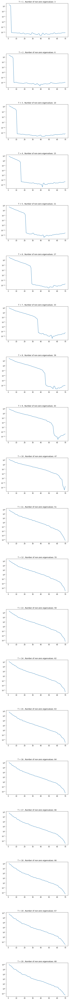

In [42]:
Xtr, Ytr, Xts, Yts = two_moons(n_samples, 5)
t_values = np.arange(1, 21)
fig, axs = plt.subplots(t_values.shape[0], 1)
axis_iterator = iter(axs)

for t in t_values:
    mean = Xtr.mean(axis=0)
    Xtr = Xtr - mean
    K = kernelMatrix(Xtr, Xtr, t, 'polynomial')
    eig_vals, eig_vec = np.linalg.eig(K)
    eig_vals = np.sort(eig_vals)[::-1]
    curr_axis = next(axis_iterator)
    num_eig = eig_vals.shape[0]
    x_data = np.arange(1, num_eig + 1)
    curr_axis.semilogy(x_data, np.abs(eig_vals))
    non_zero_eig = np.count_nonzero(np.abs(eig_vals) > 0.01)
    curr_axis.set_title("T = %s , Number of non-zero eigenvalues: %s" % (t, non_zero_eig))
    
    
fig.subplots_adjust(top=12,bottom=-12,left=-0.5,right=0.5, hspace=0.5, wspace=0.5)



We can notice that by increasing the value of t, the magnitude of the eigenvalues of the gram matrix increases. This happens because, by mapping data in higher dimensions with the parameter T, we are implicitly increasing the importance of each dimension in the dataset transformed with the kernel function, therefore we end up considering as "important" even dimensions for which the corresponding eigenvalues ("weights") were very small in the beginning. We in fact recall that the PCA algorithm retrieves the principal components from a standardized covariance matrix built from our training points $X$. Principal components are defined as the directions towards which we retrieve the most of the variance of the original dataset. The principal components are computed by performing an eigendecomposition of the covariance matrix, and are the resulting eigenvectors. The eigenvalue represents the importance (weight) of the eigenvector in explaining the variance of our original dataset. In PCA, we usually project our data points by choosing the first k eigenvalues in descending order and then by using the corresponding eigenvectors as principal components. Moreover, If we think about the SVD of our data matrix $X$, we recall that (as reported at https://en.wikipedia.org/wiki/Singular_value_decomposition and at https://hadrienj.github.io/posts/Deep-Learning-Book-Series-2.8-Singular-Value-Decomposition/) given a matrix $M$ and its SVD  $\mathbf{U}{\boldsymbol{\Sigma}}\mathbf{V}^{T}$, 


$\begin{aligned}\mathbf {M}^{T}\mathbf {M} &=\mathbf {V} {\boldsymbol {\Sigma }}^{T}\mathbf {U}^{T}\,\mathbf {U} {\boldsymbol {\Sigma }}\mathbf {V} ^{T}=\mathbf {V} ({\boldsymbol {\Sigma }}^{T}{\boldsymbol {\Sigma }})\mathbf {V} ^{T}\\\mathbf {M} \mathbf {M} ^{T}&=\mathbf {U} {\boldsymbol {\Sigma }}\mathbf {V} ^{T}\,\mathbf {V} {\boldsymbol {\Sigma }}^{T}\mathbf {U} ^{T}=\mathbf {U} ({\boldsymbol {\Sigma }}{\boldsymbol {\Sigma }}^{T})\mathbf {U} ^{T}\end{aligned}$

where the right-hand sides of these relations describe the eigenvalue decompositions of the left-hand sides. For the above, we have also the following properties:

* The columns of V (right-singular vectors) are eigenvectors of $M^TM$.
* The columns of U (left-singular vectors) are eigenvectors of $MM^T$.
* The non-zero elements of Σ (non-zero singular values) are the square roots of the non-zero eigenvalues of $M^TM$ or $MM^T$.


We can observe that the non-zero eigenvalues of $M^TM$ and $MM^T$ are equal: the same information about the weights is shared between the two decompositions. There seems to be an analogy, therefore, between the properties of principal components of the original dataset and of the transformed dataset. The difference is that, for each entry of the matrix $MM^T$, we perform element wise operations (a sum with 1 and we take a square), and what we obtain with the eigendecomposition of such result are "enhanced" weights of the principal components of the data which has been mapped to higher dimensions. In case we don't add 1 and compute the square, then we are considering nearly the same space that we would obtain by using the covariance matrix in PCA. We also observe that, since the matrix $MM^T$ is built with an outer product, it is of shape $NxN$, therefore it contains more dimensions than $M^TM$, which is $DxD$. We can therefore say that $MM^T$ will have a lot of zero eigenvalues, in opposition to a kernel matrix computed with a polynomial kernel having a large degree T, which allows us to build more complex models, as we have seen in previous plots. The space of functions considered for the training is therefore enlarged by increasing T.

Exercise 3.E


The formula used to solve the KRLS problem is the following:

$$c = (K_n + \lambda I)^{-1}Y_n$$

To solve such problem, we have first to invert the regularized Gram matrix, and then to perform a dot product with the training outputs.
If we don't make any modifications to the algorithm, as reported at https://en.wikipedia.org/wiki/Computational_complexity_of_mathematical_operations, the operation of inverting the Gram matrix takes $O(n^3)$ in the worst case, for instance using the Gauss-Jordan elimination algorithm. 

To make the algorithm more efficient, we can use the eigenvalue decomposition to diagonalize the symmetric matrix $K_n$. From such procedure, we would obtain the following decomposition:

$$K_n = U \Lambda U^{T}$$

where $U$ is the square $NxN$ matrix whose ith column is the eigenvector $u_i$ of $K_n$, and $\Lambda$ is the diagonal matrix whose diagonal elements are the corresponding eigenvalues $\lambda_{ii}$ = $\lambda_i$. Since for the hypotheses, $K_n$ has such decomposition, then it can be called a diagonalizable matrix. A diagonalizable matrix is similar to a diagonal matrix. Similar matrices represent the same linear map under two (possibly) different bases. Since $K_n$ is similar to a diagonal matrix, then it means that most of the operations could be done on the diagonal of such matrix, and therefore if we sum the diagonalized matrix with $\lambda I$, we would have to perform such operation on the diagonal of the matrix $\Lambda$ (an associated property can be found at https://en.wikipedia.org/wiki/Eigenvalues_and_eigenvectors#Additional_properties_of_eigenvalues). Moreover, in exercise 3.D, we observed that when we compute the eigenvectors of a Kernel matrix, it is like we are weighting all possible components of the transformed data with the corresponding eigenvalues. As we increase the degree of the polynomial T, we increase the magnitude of such weights, but we don't modify the corresponding directions, which lie in the feature space and depend on T. Therefore, we can assume that the matrices of eigenvectors $U$ and $U_T$ do not change if we sum to each of the eigenvalues a constant $\lambda$.
For all the previous observations, then we can define the following procedure:

* For the first value of lambda, we compute the eigenvalue decomposition $K_n = U \Lambda U^{T}$. In this case we pay exactly the amount of time as before, which is the cost of performing the eigendecomposition of a square matrix (again, $O(n^3)$).

* We store the matrix of the eigenvectors $Q$ and $\Lambda$ in memory for later use. The matrix $\Lambda$ will contain the eigenvalues of $K_n$, which will be useful later. Then, we compute the solution for the current value of lambda by inverting efficiently the matrix $K_n + \lambda I $ as reported at https://en.wikipedia.org/wiki/Eigendecomposition_of_a_matrix: in fact, $K_n + \lambda I $ is still symmetric and positive semi-definite, and therefore since $U^{-1}=U^{T}$ we pay just $O(n)$ to update the values on the diagonal of $\Lambda$ when inverting (we replace each $\lambda_{ii}$ with $\frac{1}{\lambda_{ii}}$)

* For the next value of lambda, instead of performing again the eigendecomposition, we access the matrices $Q$ and $\Lambda$ stored in memory, and we use directly the current value of lambda to perform the sum $\Lambda + \lambda I $.

* We perform again the second step, but this time we don't compute the eigendecomposition again: we can simply perform the inversion of the resulting $\Lambda = \Lambda + \lambda I $, again in $O(n)$.

* From the results obtained in the previous steps, we simply compute all the remaining dot products, starting from $U^{T}$ and $Y_n$ and then by performing the dot products with the resulting vector and the matrix to the left for each remaining matrix.

$$(U (\Lambda^{-1} (U^{T} Y_n)))$$


* By doing as in the previous step, we pay at most $3 O(n^2)$, because $O(n^2)$ is the cost in time of a matrix-vector multiplication. Therefore, we observe that the computational complexity has been improved. 
